In [20]:
import sqlite3
import pandas as pd
!pip install geopandas
import geopandas as gpd
import numpy as np
!pip install folium
import folium
!pip install pyspark
import pyspark
import matplotlib.pyplot as plt
from folium.plugins import HeatMap
from pyspark.sql.window import Window
import pyspark.sql.functions as f

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
connection = sqlite3.connect('drive/MyDrive/FPA_FOD_20170508.sqlite')
data = pd.read_sql_query('SELECT * FROM Fires', connection)
pd.set_option('max_columns', None)



data.head()

,OBJECTID,FOD_ID,FPA_ID,SOURCE_SYSTEM_TYPE,SOURCE_SYSTEM,NWCG_REPORTING_AGENCY,NWCG_REPORTING_UNIT_ID,NWCG_REPORTING_UNIT_NAME,SOURCE_REPORTING_UNIT,SOURCE_REPORTING_UNIT_NAME,LOCAL_FIRE_REPORT_ID,LOCAL_INCIDENT_ID,FIRE_CODE,FIRE_NAME,ICS_209_INCIDENT_NUMBER,ICS_209_NAME,MTBS_ID,MTBS_FIRE_NAME,COMPLEX_NAME,FIRE_YEAR,DISCOVERY_DATE,DISCOVERY_DOY,DISCOVERY_TIME,STAT_CAUSE_CODE,STAT_CAUSE_DESCR,CONT_DATE,CONT_DOY,CONT_TIME,FIRE_SIZE,FIRE_SIZE_CLASS,LATITUDE,LONGITUDE,OWNER_CODE,OWNER_DESCR,STATE,COUNTY,FIPS_CODE,FIPS_NAME,Shape
0,1,1,FS-1418826,FED,FS-FIRESTAT,FS,USCAPNF,Plumas National Forest,0511,Plumas National Forest,1,PNF-47,BJ8K,FOUNTAIN,None,None,None,None,None,2005,2453403.5,33,1300,9.0,Miscellaneous,2453403.5,33.0,1730,0.10,A,40.036944,-121.005833,5.0,USFS,CA,63,063,Plumas,b'\x00\x01\xad\x10\x00\x00\xe8d\xc2\x92_@^\xc0...
1,2,2,FS-1418827,FED,FS-FIRESTAT,FS,USCAENF,Eldorado National Forest,0503,Eldorado National Forest,13,13,AAC0,PIGEON,None,None,None,None,None,2004,2453137.5,133,0845,1.0,Lightning,2453137.5,133.0,1530,0.25,A,38.933056,-120.404444,5.0,USFS,CA,61,061,Placer,b'\x00\x01\xad\x10\x00\x00T\xb6\xeej\xe2\x19^\...
2,3,3,FS-1418835,FED,FS-FIRESTAT,FS,USCAENF,Eldorado National Forest,0503,Eldorado National Forest,27,021,A32W,SLACK,None,None,None,None,None,2004,2453156.5,152,1921,5.0,Debris Burning,2453156.5,152.0,2024,0.10,A,38.984167,-120.735556,13.0,STATE OR PRIVATE,CA,17,017,El Dorado,b'\x00\x01\xad\x10\x00\x00\xd0\xa5\xa0W\x13/^\...
3,4,4,FS-1418845,FED,FS-FIRESTAT,FS,USCAENF,Eldorado National Forest,0503,Eldorado National Forest,43,6,None,DEER,None,None,None,None,None,2004,2453184.5,180,1600,1.0,Lightning,2453189.5,185.0,1400,0.10,A,38.559167,-119.913333,5.0,USFS,CA,3,003,Alpine,b'\x00\x01\xad\x10\x00\x00\x94\xac\xa3\rt\xfa]...
4,5,5,FS-1418847,FED,FS-FIRESTAT,FS,USCAENF,Eldorado National Forest,0503,Eldorado National Forest,44,7,None,STEVENOT,None,None,None,None,None,2004,2453184.5,180,1600,1.0,Lightning,2453189.5,185.0,1200,0.10,A,38.559167,-119.933056,5.0,USFS,CA,3,003,Alpine,b'\x00\x01\xad\x10\x00\x00@\xe3\xaa.\xb7\xfb]\...


In [13]:
data = data[['FIRE_NAME', 'FIRE_YEAR', 
         'SOURCE_REPORTING_UNIT_NAME', 'STAT_CAUSE_DESCR',
         'FIRE_SIZE', 'LATITUDE',
         'LONGITUDE', 'STATE']]
x = len(data)
data.head()

,FIRE_NAME,FIRE_YEAR,SOURCE_REPORTING_UNIT_NAME,STAT_CAUSE_DESCR,FIRE_SIZE,LATITUDE,LONGITUDE,STATE
0,FOUNTAIN,2005,Plumas National Forest,Miscellaneous,0.10,40.036944,-121.005833,CA
1,PIGEON,2004,Eldorado National Forest,Lightning,0.25,38.933056,-120.404444,CA
2,SLACK,2004,Eldorado National Forest,Debris Burning,0.10,38.984167,-120.735556,CA
3,DEER,2004,Eldorado National Forest,Lightning,0.10,38.559167,-119.913333,CA
4,STEVENOT,2004,Eldorado National Forest,Lightning,0.10,38.559167,-119.933056,CA


In [14]:
spark = pyspark.sql.SparkSession.builder\
        .master('local[*]')\
        .appName('yr2145_hw2 notebook')\
        .getOrCreate()
        

In [15]:
sparkdf =spark.createDataFrame(data) 
sparkdf.head(5)

[Row(FIRE_NAME='FOUNTAIN', FIRE_YEAR=2005, SOURCE_REPORTING_UNIT_NAME='Plumas National Forest', STAT_CAUSE_DESCR='Miscellaneous', FIRE_SIZE=0.1, LATITUDE=40.03694444, LONGITUDE=-121.00583333, STATE='CA'),
 Row(FIRE_NAME='PIGEON', FIRE_YEAR=2004, SOURCE_REPORTING_UNIT_NAME='Eldorado National Forest', STAT_CAUSE_DESCR='Lightning', FIRE_SIZE=0.25, LATITUDE=38.93305556, LONGITUDE=-120.40444444, STATE='CA'),
 Row(FIRE_NAME='SLACK', FIRE_YEAR=2004, SOURCE_REPORTING_UNIT_NAME='Eldorado National Forest', STAT_CAUSE_DESCR='Debris Burning', FIRE_SIZE=0.1, LATITUDE=38.98416667, LONGITUDE=-120.73555556, STATE='CA'),
 Row(FIRE_NAME='DEER', FIRE_YEAR=2004, SOURCE_REPORTING_UNIT_NAME='Eldorado National Forest', STAT_CAUSE_DESCR='Lightning', FIRE_SIZE=0.1, LATITUDE=38.55916667, LONGITUDE=-119.91333333, STATE='CA'),
 Row(FIRE_NAME='STEVENOT', FIRE_YEAR=2004, SOURCE_REPORTING_UNIT_NAME='Eldorado National Forest', STAT_CAUSE_DESCR='Lightning', FIRE_SIZE=0.1, LATITUDE=38.55916667, LONGITUDE=-119.93305556,

In [11]:
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
temperature = gpd.read_file('drive/MyDrive/normal_mly.kml', driver='KML')
temperature = pd.DataFrame(temperature.iloc[:,:-1].values, columns = list(temperature.columns.values)[:-1] )

KeyError: ignored

In [16]:
#data.select(data.FIRE_SIZE).where(data.FIRE_YEAR == 2004).sum()
temp = sparkdf.groupby(sparkdf.FIRE_YEAR).sum()

temp = temp.withColumnRenamed("sum(FIRE_SIZE)", "sum")
temp = temp.sort("FIRE_YEAR")


[1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015]


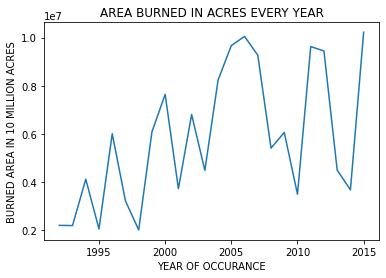

In [17]:
x_axis = [val[0] for val in temp.select('FIRE_YEAR').collect()]
y_axis = [val[0] for val in temp.select('sum').collect()]

print(x_axis)
plt.plot(x_axis,y_axis)
plt.title('AREA BURNED IN ACRES EVERY YEAR')
plt.xlabel('YEAR OF OCCURANCE')
plt.ylabel('BURNED AREA IN 10 MILLION ACRES')
plt.show()


In [18]:
sparkdf.show()

+----------+---------+--------------------------+----------------+---------+-----------+-------------+-----+
| FIRE_NAME|FIRE_YEAR|SOURCE_REPORTING_UNIT_NAME|STAT_CAUSE_DESCR|FIRE_SIZE|   LATITUDE|    LONGITUDE|STATE|
+----------+---------+--------------------------+----------------+---------+-----------+-------------+-----+
|  FOUNTAIN|     2005|      Plumas National F...|   Miscellaneous|      0.1|40.03694444|-121.00583333|   CA|
|    PIGEON|     2004|      Eldorado National...|       Lightning|     0.25|38.93305556|-120.40444444|   CA|
|     SLACK|     2004|      Eldorado National...|  Debris Burning|      0.1|38.98416667|-120.73555556|   CA|
|      DEER|     2004|      Eldorado National...|       Lightning|      0.1|38.55916667|-119.91333333|   CA|
|  STEVENOT|     2004|      Eldorado National...|       Lightning|      0.1|38.55916667|-119.93305556|   CA|
|    HIDDEN|     2004|      Eldorado National...|       Lightning|      0.1|38.63527778|-120.10361111|   CA|
|      FORK|     20

In [30]:
sparkdf.select("STAT_CAUSE_DESCR").distinct().show()


temp = sparkdf.groupby(sparkdf.STAT_CAUSE_DESCR).sum()
temp = temp.withColumnRenamed("sum(FIRE_SIZE)", "sum")
temp.show()



+-----------------+
| STAT_CAUSE_DESCR|
+-----------------+
|    Miscellaneous|
|          Smoking|
|        Lightning|
|         Campfire|
|            Arson|
|   Debris Burning|
|         Railroad|
|        Powerline|
|Missing/Undefined|
|        Structure|
|         Children|
|        Fireworks|
|    Equipment Use|
+-----------------+

+-----------------+--------------+--------------------+--------------------+--------------------+----------+
| STAT_CAUSE_DESCR|sum(FIRE_YEAR)|                 sum|       sum(LATITUDE)|      sum(LONGITUDE)|sum(count)|
+-----------------+--------------+--------------------+--------------------+--------------------+----------+
|    Miscellaneous|     649331273|1.4394204201972745E7| 1.212782890711749E7|-3.09439233556645...|    323805|
|          Smoking|     105858079|   842660.5221999458|  1979206.6599779837|  -4943519.007145206|     52869|
|        Lightning|     557844978|   8.7033501016713E7|1.0972559546781246E7|-3.013756282514252E7|    278468|
|    

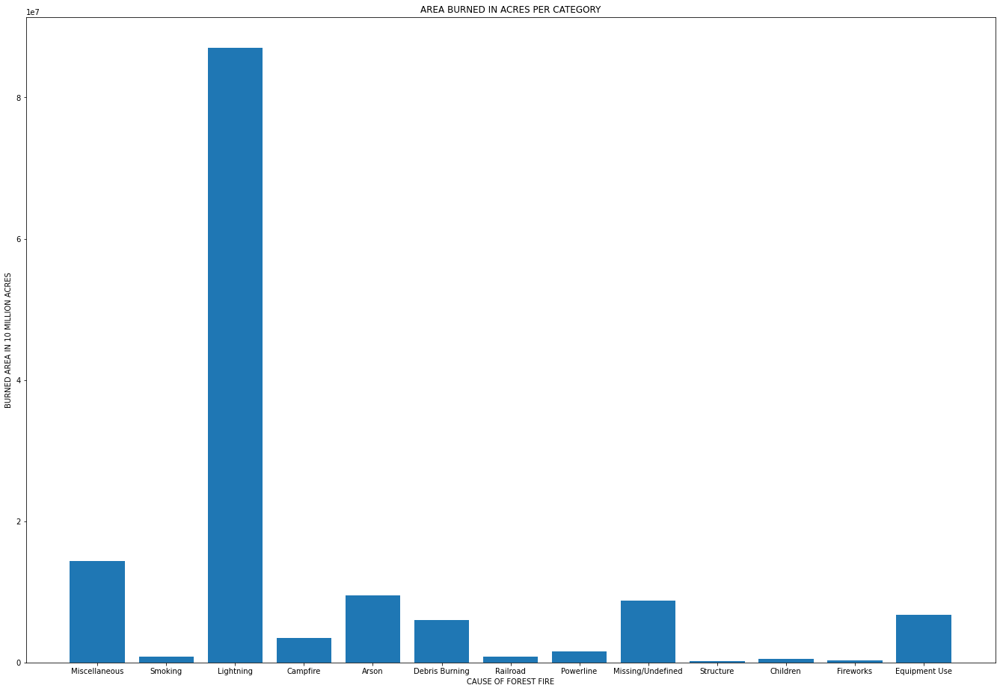

In [ ]:
fig = plt.figure()
ax = fig.add_axes([0,0,3,3])
langs = [i[0] for i in sparkdf.select("STAT_CAUSE_DESCR").distinct().collect()]
students = [i[0] for i in temp.select("sum").collect()]
ax.bar(langs,students)
plt.title('AREA BURNED IN ACRES PER CATEGORY')
plt.xlabel('CAUSE OF FOREST FIRE')
plt.ylabel('BURNED AREA IN 10 MILLION ACRES')
plt.show()

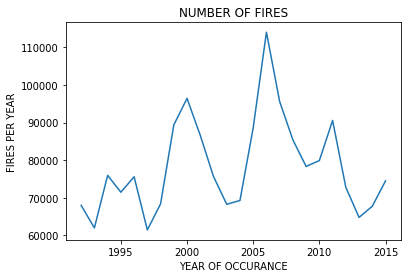

In [47]:
#sparkdf = sparkdf.withColumn('count', f.lit(1))
here = sparkdf.select("FIRE_YEAR", "count")
here = here.withColumn('count', f.count('count').over(Window.partitionBy( sparkdf.FIRE_YEAR))).distinct().sort("FIRE_YEAR")

x_axis = [val[0] for val in here.select('FIRE_YEAR').collect()]
y_axis = [val[0] for val in here.select('count').collect()]

plt.plot(x_axis,y_axis)
plt.title('NUMBER OF FIRES')
plt.xlabel('YEAR OF OCCURANCE')
plt.ylabel('FIRES PER YEAR')
plt.show()

In [ ]:
here = sparkdf.select("FIRE_SIZE", "count")
for i in here:
  
here.withColumn('count', f.count('count').over(Window.partitionBy( sparkdf.FIRE_SIZE))).distinct().sort("FIRE_SIZE").show(25)

In [ ]:
print(min(data['FIRE_SIZE']))
print(max(data['FIRE_SIZE']))

1e-05
606945.0


In [ ]:
data = data.loc[data['FIRE_SIZE'] > 100]

In [ ]:
m = folium.Map(location = [40.44, -104.81],
               tiles = 'Stamen Terrain',
               zoom_start = 6)



Class_A = folium.FeatureGroup(name = '1,000 Acres to 10,000 Acres - Class D')
Class_B = folium.FeatureGroup(name = '10,000 Acres to 50,000 Acres - Class E')
Class_C = folium.FeatureGroup(name = 'More than 50,000 Acres - Class G')



for i, v in data.iterrows():
    
    size = float(v['FIRE_SIZE'])
    
    popup = """
    Name : %s<br>
    Size : %s<br>
    State : %s<br>
    Cause : %s<br>
    Year: %s<br>
    """ % (v['FIRE_NAME'], v['FIRE_SIZE'], 
           v['STATE'], v['STAT_CAUSE_DESCR'], 
           v['FIRE_YEAR'])
    
    
        
    if size in range(1000, 10000):
        folium.CircleMarker(location = [v['LATITUDE'], 
                                        v['LONGITUDE']],
                           radius = np.log(size),
                           weight = 0,
                           tooltip = popup,
                           color = '#feb24c',
                           fill_color = '#feb24c',
                           fill_opacity = 0.5,
                           fill = True).add_to(Class_A)
    
    if size in range(10000, 50000):
        folium.CircleMarker(location = [v['LATITUDE'], 
                                        v['LONGITUDE']],
                           radius = np.log(size)*1.4,
                           weight = 0,
                           tooltip = popup,
                           color = '#fc4e2a',
                           fill_color = '#fc4e2a',
                           fill_opacity = 0.6,
                           fill = True).add_to(Class_B)

    if size > 50000:
        folium.CircleMarker(location = [v['LATITUDE'], 
                                        v['LONGITUDE']],
                           radius = np.log(size)*1.8,
                           weight = 0,
                           tooltip = popup,
                           color = '##b10026',
                           fill_color = '#b10026',
                           fill_opacity = 0.7,
                           fill = True).add_to(Class_C)

Class_A.add_to(m)
Class_B.add_to(m)
Class_C.add_to(m)
folium.LayerControl(collapsed = False).add_to(m)

m

In [ ]:
m = folium.Map(location = [40.44, -104.81],
               tiles = 'Stamen Terrain',
               zoom_start = 6)



Class_A = folium.FeatureGroup(name = '500 Acres to 1,000 Acres - Class D')

for i, v in data.iterrows():
    
    size = float(v['FIRE_SIZE'])
    
    popup = """
    Name : %s<br>
    Size : %s<br>
    State : %s<br>
    Cause : %s<br>
    Year: %s<br>
    """ % (v['FIRE_NAME'], v['FIRE_SIZE'], 
           v['STATE'], v['STAT_CAUSE_DESCR'], 
           v['FIRE_YEAR'])
    
    
        
    if size in range(500, 1000):
        folium.CircleMarker(location = [v['LATITUDE'], 
                                        v['LONGITUDE']],
                           radius = np.log(size),
                           weight = 0,
                           tooltip = popup,
                           color = '#feb24c',
                           fill_color = '#feb24c',
                           fill_opacity = 0.5,
                           fill = True).add_to(Class_A)

Class_A.add_to(m)
folium.LayerControl(collapsed = False).add_to(m)

m

In [ ]:
m = folium.Map(location = [40.44, -104.81],
               tiles = 'Stamen Terrain',
               zoom_start = 6)



Class_A = folium.FeatureGroup(name = '500 Acres to 1,000 Acres - Class D')

for i, v in data.iterrows():
    
    size = float(v['FIRE_SIZE'])
    
    popup = """
    Name : %s<br>
    Size : %s<br>
    State : %s<br>
    Cause : %s<br>
    Year: %s<br>
    """ % (v['FIRE_NAME'], v['FIRE_SIZE'], 
           v['STATE'], v['STAT_CAUSE_DESCR'], 
           v['FIRE_YEAR'])
    
    
        
    if size in range(300, 500):
        folium.CircleMarker(location = [v['LATITUDE'], 
                                        v['LONGITUDE']],
                           radius = np.log(size),
                           weight = 0,
                           tooltip = popup,
                           color = '#feb24c',
                           fill_color = '#feb24c',
                           fill_opacity = 0.5,
                           fill = True).add_to(Class_A)

Class_A.add_to(m)
folium.LayerControl(collapsed = False).add_to(m)

m

In [ ]:
map_hooray = folium.Map(location=[40.44, -104.81],
                    zoom_start = 5) 

data['LATITUDE'] = data['LATITUDE'].astype(float)
data['LONGITUDE'] = data['LONGITUDE'].astype(float)
heat_data = data.loc[data['FIRE_SIZE'] > 1000]
heat_data = data[['LATITUDE', 'LONGITUDE']]
heat_data = heat_data.dropna(axis=0, subset=['LATITUDE','LONGITUDE'])

heat= [[row['LATITUDE'],row['LONGITUDE']] for index, row in heat_data.iterrows()]

HeatMap(heat).add_to(map_hooray)

map_hooray